# Delivery Network Analysis
---
**Author:** Tigran Khachatryan

In [1]:
from datetime import datetime
from operator import itemgetter

import numpy as np
import pandas as pd
import networkx as nx
import osmnx as ox

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns
%matplotlib inline

import folium
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster


In [2]:
source_df = pd.read_csv('data/orders.csv')
df = source_df.copy()
df['TIMESTAMP'] = pd.to_datetime(df['TIMESTAMP'])
df.sample(5)

,TIMESTAMP,ACTUAL_DELIVERY_MINUTES - ESTIMATED_DELIVERY_MINUTES,ITEM_COUNT,USER_LAT,USER_LONG,VENUE_LAT,VENUE_LONG,ESTIMATED_DELIVERY_MINUTES,ACTUAL_DELIVERY_MINUTES,CLOUD_COVERAGE,TEMPERATURE,WIND_SPEED,PRECIPITATION
11007,2020-09-07 08:19:00,3,1,60.167,24.939,60.169,24.941,37,40,25.0,17.2,3.78720,0.0
17020,2020-09-25 17:55:00,8,4,60.174,24.930,60.188,24.956,25,33,0.0,15.6,2.64942,0.0
17365,2020-09-26 16:55:00,16,1,60.197,24.951,60.195,24.951,31,47,0.0,16.7,3.17216,0.0
8570,2020-08-30 09:47:00,17,3,60.167,24.961,60.167,24.966,30,47,0.0,12.8,3.96516,0.0
3372,2020-08-13 08:10:00,0,4,60.187,24.919,60.188,24.956,34,34,0.0,14.4,4.08278,0.0


In [3]:
def plot_folium_map(df: pd.DataFrame) -> None:
    """
    This function plots the user/Venue coordinates on a map.
    ---
    Args:
        df: pd.Dataframe
        
    Returns: None
    """
    mappy = folium.Map(location=[60.1699, 24.9384], tiles='cartodbpositron', zoom_start=13)

    for i in range(0,len(df)):
        Circle(
            location=[df.iloc[i]['VENUE_LAT'],
                      df.iloc[i]['VENUE_LONG']],
            radius=20,
            color='grey').add_to(mappy)

    for i in range(0,len(df)):
        Circle(
            location=[df.iloc[i]['USER_LAT'],
                      df.iloc[i]['USER_LONG']],
            radius=10).add_to(mappy)
        
    return mappy

plot_folium_map(df)

## Delivery Network EDA
---
We will create a network using unique origin and destination coordinates as nodes.

In [4]:
def create_graph(df: pd.DataFrame) -> nx.Graph:
    """
    This function creates a nx.Graph object from the input dataframe.
    ---
    Args:
        df: pd.Dataframe
        
    Returns: 
        G (nx.Graph): Graphs object from pandas O-D edge list.
    """
    df['origin'] = list(zip(df['VENUE_LONG'], df['VENUE_LAT']))
    df['destination'] = list(zip(df['USER_LONG'], df['USER_LAT']))

    G = nx.from_pandas_edgelist(df,
                                source='origin',
                                target='destination',
                                edge_attr=['ACTUAL_DELIVERY_MINUTES',
                                           'ESTIMATED_DELIVERY_MINUTES', 
                                           'ITEM_COUNT'],
                                create_using=nx.DiGraph()
                               )
    
    attrs = {}
    for index, node in enumerate(G.nodes()):
        lat, long = node
        attrs[node] = {'pos': node}
        
    nx.set_node_attributes(G, attrs)
    G = nx.convert_node_labels_to_integers(G, first_label=1)
    
    return G


G = create_graph(df)

Let's view the stats of the delivery network.

In [5]:
def network_stats(G):
    """
    This function prints the basic properties of the graph.
    """
    print(nx.info(G))
    
    density = nx.density(G)
    print("Network density:", density)

    # In-degrees
    in_degree_dict = dict(G.in_degree(G.nodes()))
    sorted_in_degree = sorted(in_degree_dict.items(), key=itemgetter(1), reverse=True)
    print("\nTop 5 Users that have the most diverse diets (in degree):")
    for d in sorted_in_degree[:5]:
        print(d)
        
    # Out-degrees
    out_degree_dict = dict(G.out_degree(G.nodes()))
    sorted_out_degree = sorted(out_degree_dict.items(), key=itemgetter(1), reverse=True)
    print("\nTop 5 Venues with most unique users (out degree):")
    for d in sorted_out_degree[:5]:
        print(d)
        

network_stats(G)

DiGraph with 2098 nodes and 15901 edges
Network density: 0.0036142694202485463

Top 5 Users that have the most diverse diets (in degree):
(322, 35)
(379, 33)
(456, 32)
(492, 32)
(556, 32)

Top 5 Venues with most unique users (out degree):
(39, 362)
(21, 350)
(9, 337)
(90, 337)
(100, 274)


In [6]:
def cdf(G):
    """
    Calculates the cumulative distribution function of input_list;
    cdf(k) = p that value smaller than k
    ---
    Args:
        input_list : list of numbers used to compute the cdf

    Returns:
        x_points: the values for which the cdf is computed
        cdf (np.array): cdf for the above values 
    """
    degrees = []
    degree = G.degree()
    for (n,d) in degree:
        degrees.append(d)
        
    input_array = np.array(degrees)
    x_points = np.unique(input_array) 
    cdf = []
    normalizer=float(input_array.size)

    for x in x_points:
        cdf.append((input_array[np.where(input_array < x)].size)/normalizer)

    return (x_points, np.array(cdf))


def plot_distribution(y_values, x_values):
    """
    Plots the pre-calculated distribution y(x)
    Returns the figure object

    """
    fig = plt.figure(figsize=(12,10))
    
    ax = fig.add_subplot(111) 
    ax.set_title('Complementary Cumulative Degree Distribution 1-CDF(k) for delivery Network', fontsize = 14)
    ax.loglog(x_values, y_values, '#3cb4dc', marker='.')
    
    ax.set_xlabel('Degrees', fontsize = 12)
    ax.set_ylabel('1-CFD', fontsize = 12) 
    
    # Legend & Grid
    plt.grid(linestyle=":", color='grey')
    plt.show()

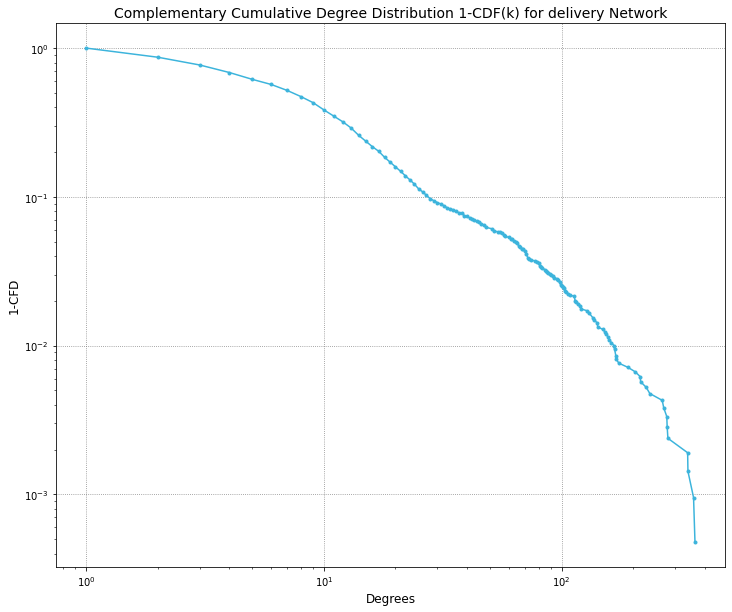

In [7]:
cdf_x_values, cdf_vals = cdf(G)
plot_distribution(1-cdf_vals, cdf_x_values)

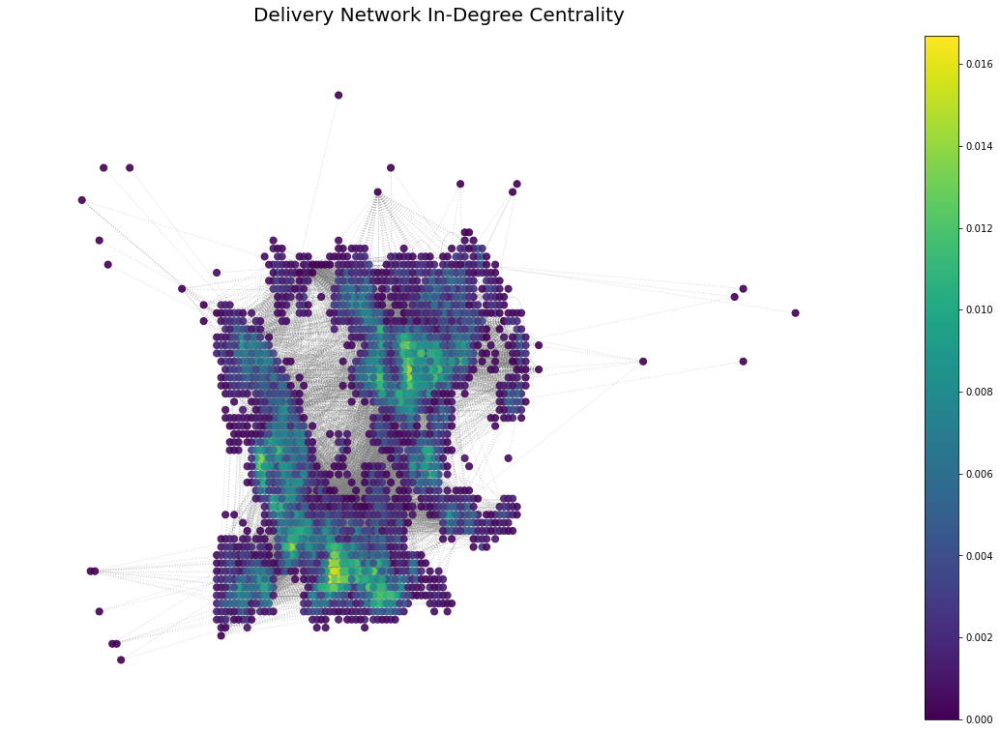

In [8]:
def plot_in_centrality_degree(G: nx.Graph) -> dict:
    """
    This function plots an interactive City bike network with node degrees
    """
    # Figure
    fig, ax = plt.subplots(figsize=(20, 13), facecolor='w')

    in_degree = nx.in_degree_centrality(G)
    node_color = [in_degree[i] for i in in_degree.keys()]

    # Color scale
    colors=range(10)
    cmap=plt.cm.viridis
    vmin = min(node_color)
    vmax = max(node_color)
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin = vmin, vmax=vmax))
    plt.colorbar(sm)

    # Draw
    nx.draw_networkx_nodes(G=G, pos=G.nodes.data('pos'), node_color=node_color,cmap="viridis", alpha=.9, node_size=50)
    nx.draw_networkx_edges(G=G, pos=G.nodes.data('pos'), edge_color='grey', style ="dotted", alpha=0.3, arrows=False)

    # Labeling
    ax.set_title('Delivery Network In-Degree Centrality', fontdict={"fontsize":20}, pad = 15)
    ax.axis('off')
    return in_degree
    
in_degree = plot_in_centrality_degree(G)

### Observations
- The high in-degree nodes are the users who order from a vast range of resturants.
- We can see that Kamppi, Kallio and Töölö are the centers for the userswith diverse diets.
- This can be caused by having many resturants available in close proximity. 


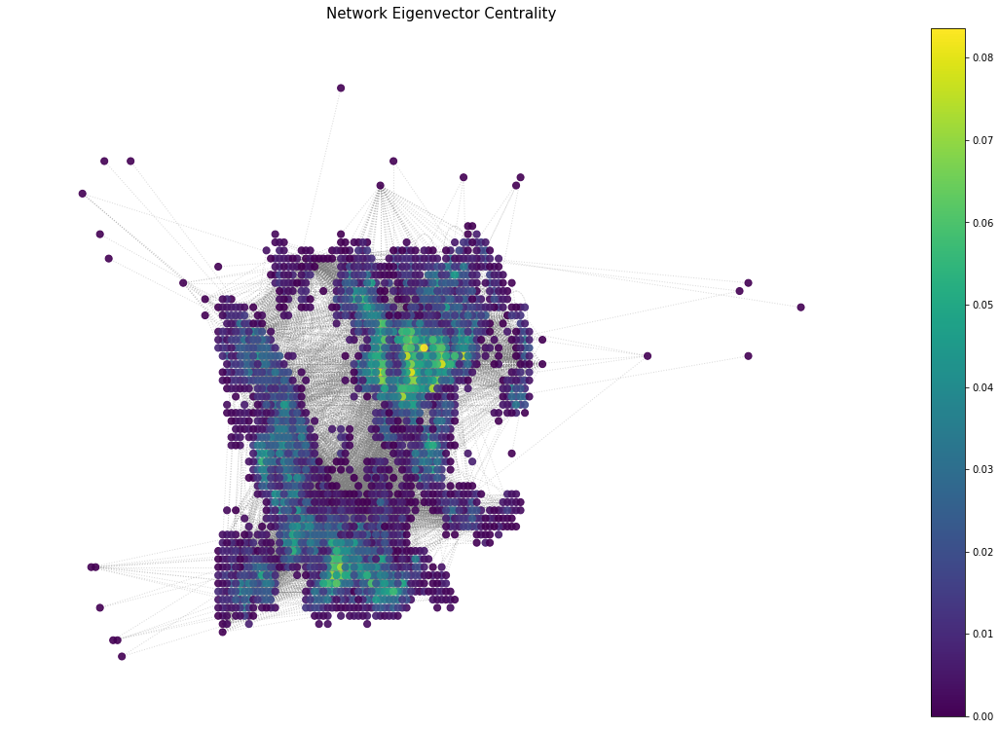

In [9]:
def plot_centrality_eigenvector(G: nx.Graph):
    """
    This function plots the city bike network Eigenvector centrality
    """
    
    # Figure
    fig, ax = plt.subplots(figsize=(20, 13), facecolor='w')

    eigenvector = nx.eigenvector_centrality(G, max_iter=6000, weight="duration")
    node_color = [eigenvector[i] for i in eigenvector.keys()]

    # Color scale
    colors=range(20)
    cmap=plt.cm.viridis
    vmin = min(node_color)
    vmax = max(node_color)
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin = vmin, vmax=vmax))
    sm._A = []
    plt.colorbar(sm)

    # Draw
    nx.draw_networkx_nodes(G=G, pos=G.nodes.data('pos') ,node_color=node_color,cmap="viridis", alpha=.9, node_size=50)
    nx.draw_networkx_edges(G=G, pos=G.nodes.data('pos') ,edge_color='grey', style ="dotted", alpha=0.3, arrows=False)

    # Labeling Axes
    ax.set_title('Network Eigenvector Centrality', fontdict={"fontsize":15}, pad=10)
    #plt.xlim([24.895, 24.995])
    #plt.ylim([60.14, 60.211])
    ax.axis('off')


plot_centrality_eigenvector(G)

# OSMNX

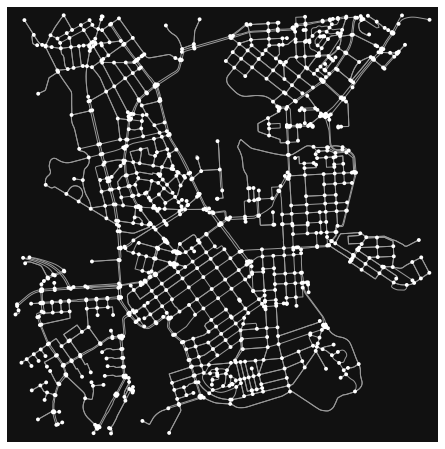

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)

In [10]:
centroid=[60.1699, 24.9384]
mode = "drive"
G = ox.graph_from_point(centroid, dist=2000, simplify=True, network_type=mode)
ox.plot_graph(G, node_color='w')